In [1]:
!cat requirements.txt

tqdm
toml
image
ffmpeg-python
Pillow
beautifulsoup4
requests

In [2]:
!pip install -r requirements.txt
!python --version

Python 3.12.0


# If no script file name provided, we use ChatGPT generate the script, the steps are as follows:
1. List the predefined characters work well with stable diffusion and FakeYou.
2. Provide a short story prompt involve the characters listed above.
3. Identify the characters included in your prompt, and confirm with you whether to include this character in the generated script.
4. Confirm whether you are satisfied with the script generated by ChatGPT. If not, regenerate a new script.

# otherwise, load the script from the script file.

In [3]:
import tomllib
import toml
from fakeyou import get_possible_characters_from_prompt
from user_input import select_characters
from script_generator import generate_script

# script_file = 'out/script_2023-11-24-13-02-36.toml'
script_file = None

if script_file == None:
    with open('./characters.toml', 'rb') as f:
        curated_characters = tomllib.load(f)
        print("Popular characters that work well with stable diffusion and FakeYou are:\n")
        for character_name in curated_characters.keys():
            print(f'  #{character_name}')
        print("\n\n")
        prompt = input("Enter a prompt to generate the video script.\n Provide a short story prompt involve the characters listed above:\n")
        possible_characters = get_possible_characters_from_prompt(prompt)
        characters = select_characters(possible_characters, high_quality_audio=True, full_auto=False)
        script = generate_script(characters, prompt)
else:
    with open(script_file, "rb") as f:
        script = tomllib.load(f)

print(f'The Script used generate the video as below:\n {toml.dumps(script)}')

Popular characters that work well with stable diffusion and FakeYou are:

  #GLaDOS
  #Homer Simpson
  #Samuel L. Jackson
  #Morgan Freeman
  #Wallace
  #Yugi
  #Shrek
  #Yoda
  #Weird Al
  #Joey Wheeler
  #Seto Kaiba
  #Tristan Taylor
  #Mokuba Kaiba
  #Mai Valentine
  #Mario
  #Luigi
  #Bill Nye
  #Wario
  #Slippy Toad
  #Voldemort
  #Kurzgesagt
  #Donkey
  #Tobey Maguire
  #Gandhi
  #Donald Trump
  #Barack Obama
  #Jack Sparrow
  #Jaiden Animations
  #Shaggy Rogers
  #Scooby Doo
  #Ash Ketchum
  #Meowth
  #Queen Elizabeth II
  #Elon Musk
  #TheOdd1sOut





Enter a prompt to generate the video script.
 Provide a short story prompt involve the characters listed above:
 Musk tells Trump the story of landing on Mars


Searching for characters in prompt:: 100%|██████████████████████████████████████████████████████████████████████| 3813/3813 [00:00<00:00, 339537.20it/s]


--- Character Voice Selection ---

Character detected in prompt: Donald Trump

0. Do not include this character.
1. Donald Trump (Angry) by Vegito1089 (default)
2. Donald Trump (Casual Speech) by Vegito1089
3. Donald Trump (OLD, 45th U.S. President) by BibbyBob
4. Donald Trump (Sarcastic) by Vegito1089
5. Donald Trump (Version 1.0) by Vegito1089
6. Donald Trump (Version 2.0) by Vegito1089
7. Donald Trump (Version 3.0) by Vegito1089



Which voice do you want to use for this character? (number)  7



Character detected in prompt: Elon Musk

0. Do not include this character.
1. Elon Musk (New Version 2.0) by Vegito1089
2. Elon Musk (Version 1.0) [OLD / DO NOT USE] by Vegito1089
3. Elon Musk (Version 1.5) [OLD / DO NOT USE] by Vegito1089 (default)
4. Elon Musk (Version 3.0) by Vegito1089



Which voice do you want to use for this character? (number)  4


Generating script draft...
Style:  comedy

Script:
 Elon Musk: (Elon Musk excitedly pointing at a globe with Mars highlighted) So, Mr. President, let me tell you about the time we landed on Mars.
Donald Trump: (Donald Trump with a skeptical expression, holding a newspaper with a headline 'Elon Musk: Mission to Mars Accomplished') Wait, you actually made it to Mars? I thought it was just a hoax!
Elon Musk: (Elon Musk proudly showing a rocket model with Mars in the background) No, it's real! We sent a rocket called Falcon Heavy, and it successfully reached Mars.
Donald Trump: (Donald Trump holding a magnifying glass, pretending to search for aliens on Mars) And what did you find there?
Elon Musk: (Elon Musk holding a rock and pretending to listen to it, with a comical expression) Well, we haven't found aliens yet, but we did find some really interesting rock formations.
Donald Trump: (Donald Trump with a disappointed expression, holding a toy UFO) Rock formations? That's it? I was expect

Do you approve this script? (y/n/q):  y


The Script used generate the video as below:
 title = "Elon Musk Tells Trump the Mars Landing Story"
description = "Elon Musk hilariously recounts his journey to landing on Mars to Donald Trump."
global_image_style = "comedy"
bgm_category = "upbeat"
[[characters]]
name = "Donald Trump"
default_image_prompt = "Donald Trump with his signature hairstyle"
voice_token = "TM:djceg00wmcv5"

[[characters]]
name = "Elon Musk"
default_image_prompt = "Elon Musk wearing a SpaceX t-shirt"
voice_token = "TM:0vckhrxztgcw"

[[lines]]
character = "Elon Musk"
speech = "So, Mr. President, let me tell you about the time we landed on Mars."
image_prompt = "Elon Musk excitedly pointing at a globe with Mars highlighted"

[[lines]]
character = "Donald Trump"
speech = "Wait, you actually made it to Mars? I thought it was just a hoax!"
image_prompt = "Donald Trump with a skeptical expression, holding a newspaper with a headline 'Elon Musk: Mission to Mars Accomplished'"

[[lines]]
character = "Elon Musk"
speech

# Organize the dialogue between characters based on the script.

In [4]:
from model import Character, Line
characters = [Character(
        character['name'],
        voice_token=character['voice_token'],
        default_image_prompt=character['default_image_prompt']
    ) for character in script['characters']]

def find_character(name: str):
        return next(filter(lambda character: character.name == name, characters))

lines = [Line(
        character=find_character(line['character']),
        speech=line['speech'],
        image_prompt=line.get('image_prompt', None) or find_character(line['character']).default_image_prompt
    ) for line in script['lines']]

# Use the FakeYou API to generate voice clips for all dialogues.

In [5]:
from IPython.display import Audio, display
from fakeyou import generate_voice_clips

generate_voice_clips(lines, characters)

voiceovers =  [f"./tmp/{i+1}.wav" for i in range(len(lines))]
for voice in voiceovers:
    display(Audio(voice))

Starting voice jobs:   0%|                                                                                                        | 0/7 [00:00<?, ?it/s]

Sent to Fakeyou:

{'uuid_idempotency_token': '1d0a06b2-5b61-4ee9-8d10-66a9a94ae35d', 'tts_model_token': 'TM:0vckhrxztgcw', 'inference_text': 'So, Mr. President, let me tell you about the time we landed on Mars.'}


Rec from Fakeyou:

{'success': True, 'inference_job_token': 'JTINF:bqen1vekx6k14fb0hv86w7n61f', 'inference_job_token_type': 'legacy_tts'}




Starting voice jobs:  14%|█████████████▋                                                                                  | 1/7 [00:53<05:23, 53.85s/it]

Sent to Fakeyou:

{'uuid_idempotency_token': '7d8752b8-fb30-42e6-8975-a12d1048f9af', 'tts_model_token': 'TM:djceg00wmcv5', 'inference_text': 'Wait, you actually made it to Mars? I thought it was just a hoax!'}


Rec from Fakeyou:

{'success': True, 'inference_job_token': 'JTINF:s4n9b8a6p1227tn4yqyf40sgw5', 'inference_job_token_type': 'legacy_tts'}




Starting voice jobs:  29%|███████████████████████████▍                                                                    | 2/7 [01:47<04:28, 53.63s/it]

Sent to Fakeyou:

{'uuid_idempotency_token': '31cb02da-aa88-4e0d-980c-7cc7652c7dfa', 'tts_model_token': 'TM:0vckhrxztgcw', 'inference_text': "No, it's real! We sent a rocket called Falcon Heavy, and it successfully reached Mars."}


Rec from Fakeyou:

{'success': True, 'inference_job_token': 'JTINF:m4w784c3pd06myfefq1wpferr0', 'inference_job_token_type': 'legacy_tts'}




Starting voice jobs:  43%|█████████████████████████████████████████▏                                                      | 3/7 [02:40<03:34, 53.63s/it]

Sent to Fakeyou:

{'uuid_idempotency_token': 'ef98d192-2f81-4285-94b0-cb9f5a4d91a1', 'tts_model_token': 'TM:djceg00wmcv5', 'inference_text': 'And what did you find there?'}


Rec from Fakeyou:

{'success': True, 'inference_job_token': 'JTINF:1xsvak1ey690wv8j9mevfksp7c', 'inference_job_token_type': 'legacy_tts'}




Starting voice jobs:  57%|██████████████████████████████████████████████████████▊                                         | 4/7 [03:34<02:40, 53.51s/it]

Sent to Fakeyou:

{'uuid_idempotency_token': 'bf7c71c4-0bf0-4e3a-aa5d-f32554407158', 'tts_model_token': 'TM:0vckhrxztgcw', 'inference_text': "Well, we haven't found aliens yet, but we did find some really interesting rock formations."}


Rec from Fakeyou:

{'success': True, 'inference_job_token': 'JTINF:zdchh3h85184p62jsrwqq3vw1e', 'inference_job_token_type': 'legacy_tts'}




Starting voice jobs:  71%|████████████████████████████████████████████████████████████████████▌                           | 5/7 [04:27<01:46, 53.39s/it]

Sent to Fakeyou:

{'uuid_idempotency_token': '982b5e5b-cf87-4cee-a7e6-1711e4e1bc3a', 'tts_model_token': 'TM:djceg00wmcv5', 'inference_text': "Rock formations? That's it? I was expecting Martians and flying saucers!"}


Rec from Fakeyou:

{'success': True, 'inference_job_token': 'JTINF:wjjz6r8cfw13bsjj1yxjnwv800', 'inference_job_token_type': 'legacy_tts'}




Starting voice jobs:  86%|██████████████████████████████████████████████████████████████████████████████████▎             | 6/7 [05:20<00:53, 53.39s/it]

Sent to Fakeyou:

{'uuid_idempotency_token': '79101dc0-28b8-4d81-9cd5-a7a71a6c76e8', 'tts_model_token': 'TM:0vckhrxztgcw', 'inference_text': "Sorry to disappoint, Mr. President. But we're still exploring and aiming for more!"}


Rec from Fakeyou:

{'success': True, 'inference_job_token': 'JTINF:g75wtwpvrxhpd5gap473vr2nky', 'inference_job_token_type': 'legacy_tts'}




Waiting for audio to render: 100%|████████████████████████████████████████████████████████████████████████████████████████| 7/7 [01:33<00:00, 13.34s/it]


# Use the Stability API to generate static images for all dialogue scenes.

Generating images: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 7/7 [01:11<00:00, 10.24s/it]


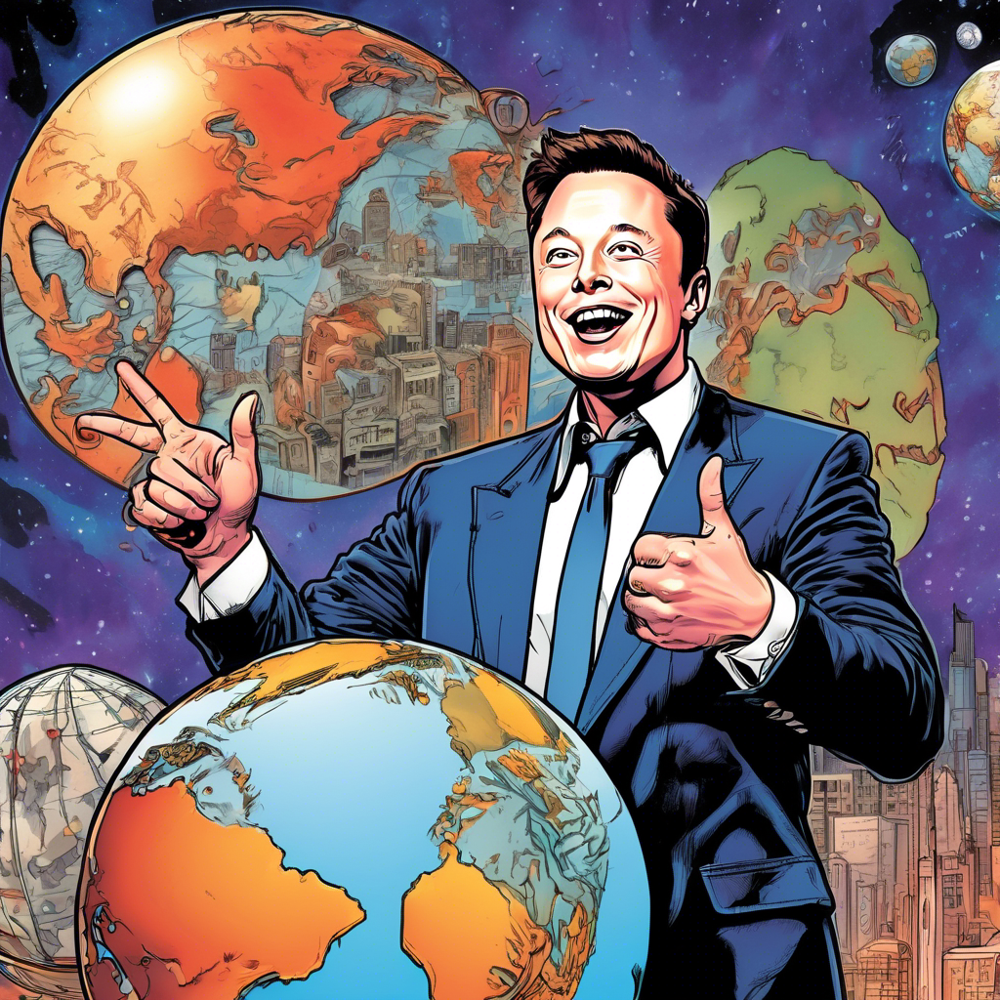

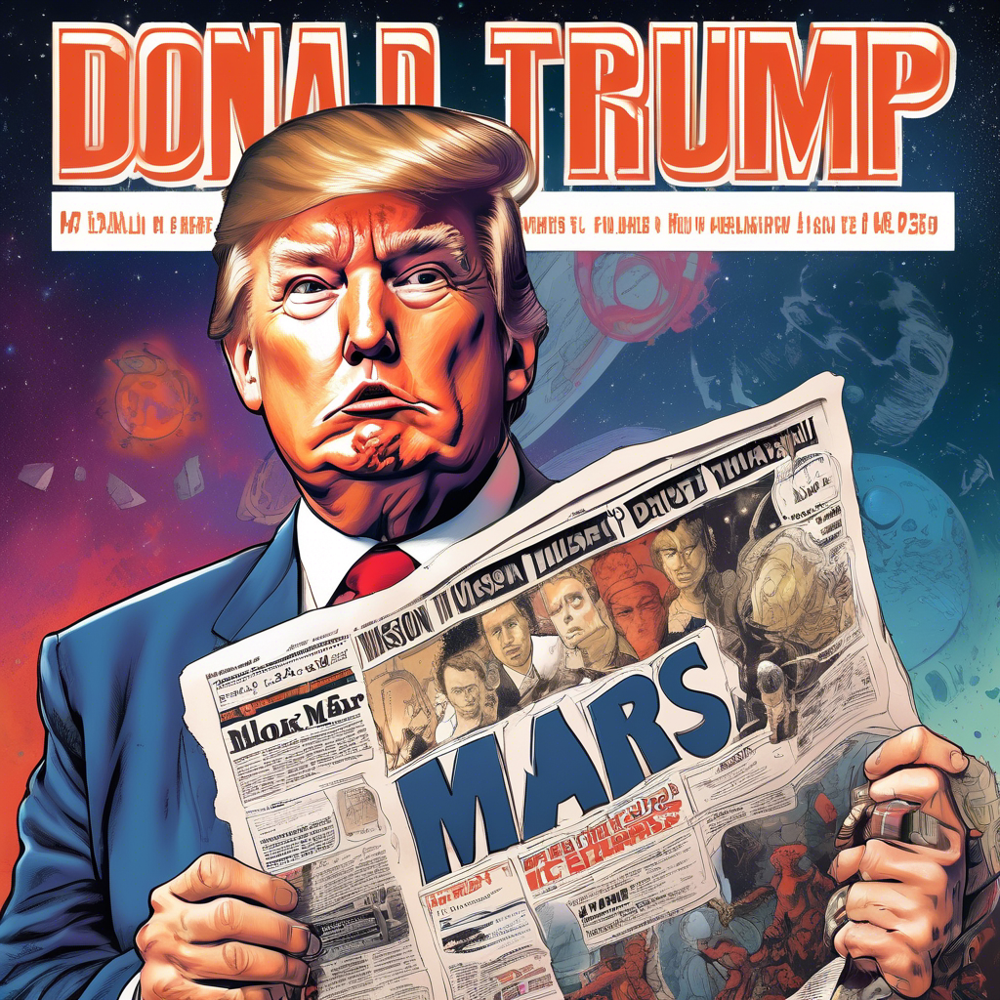

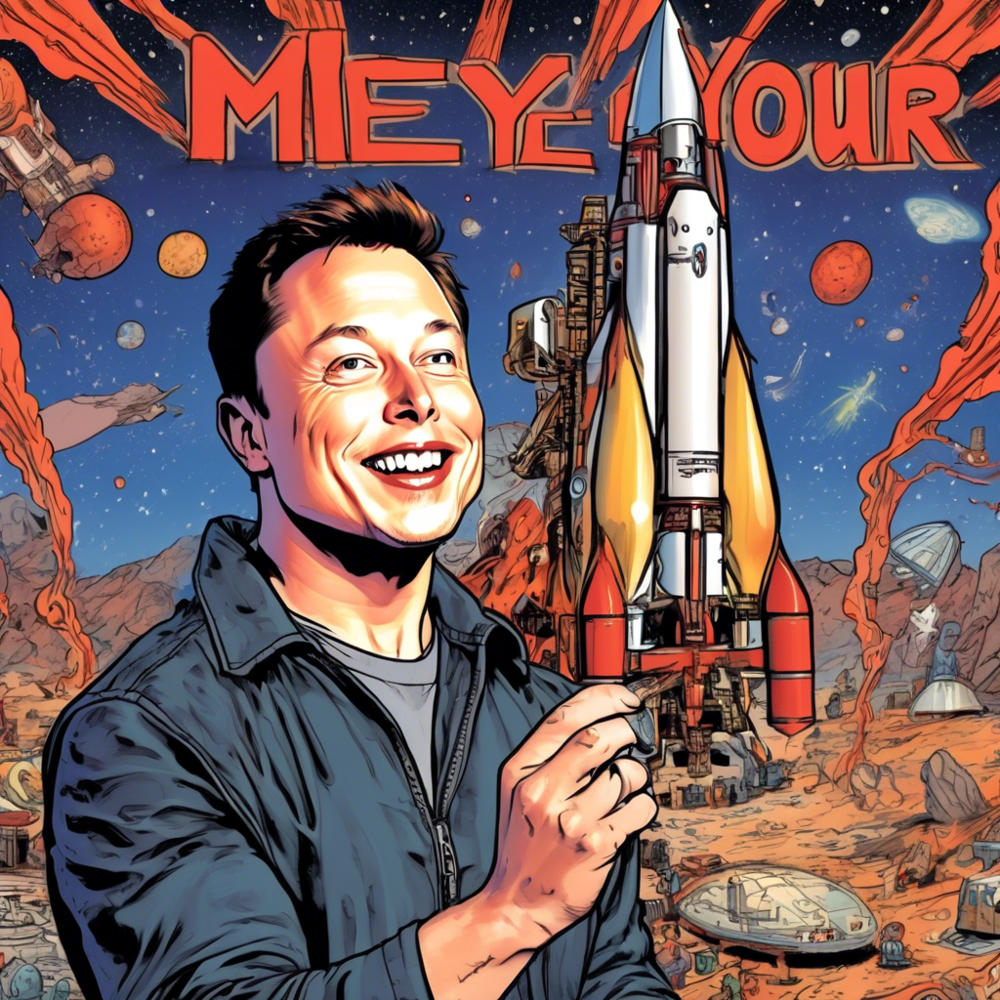

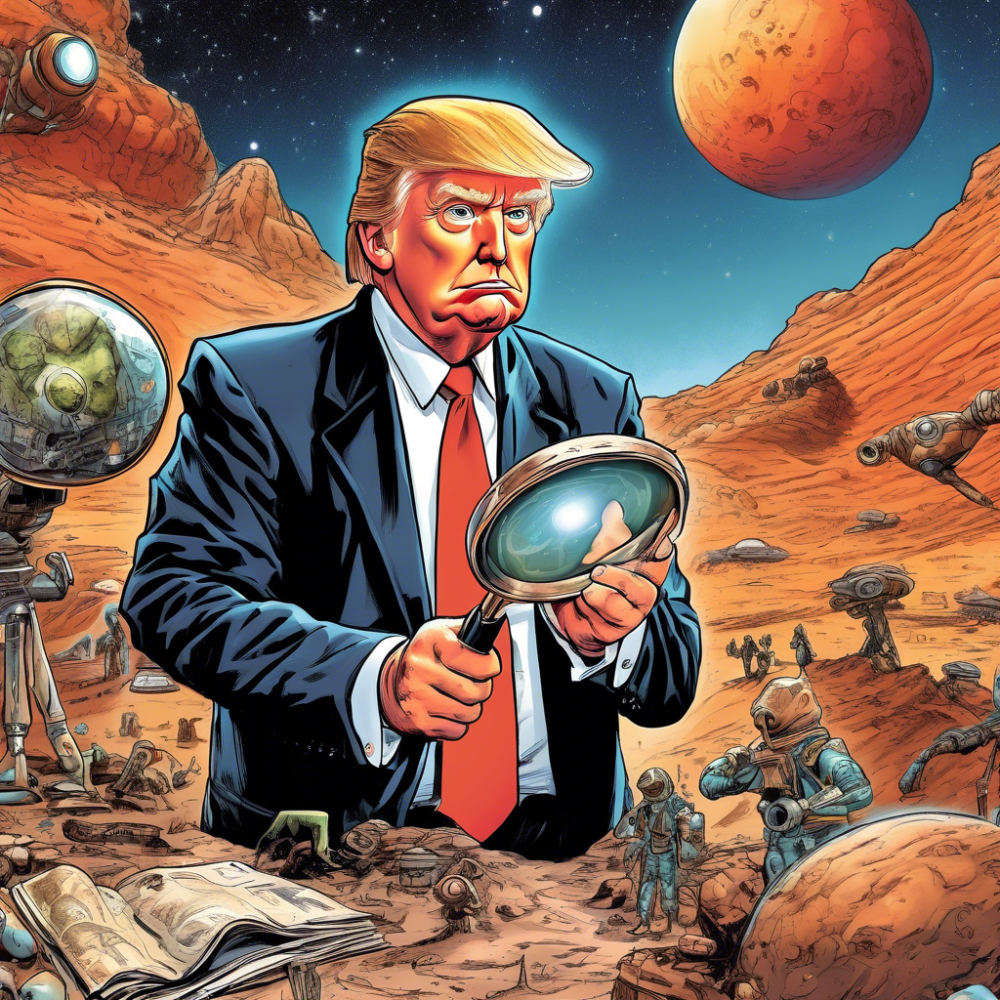

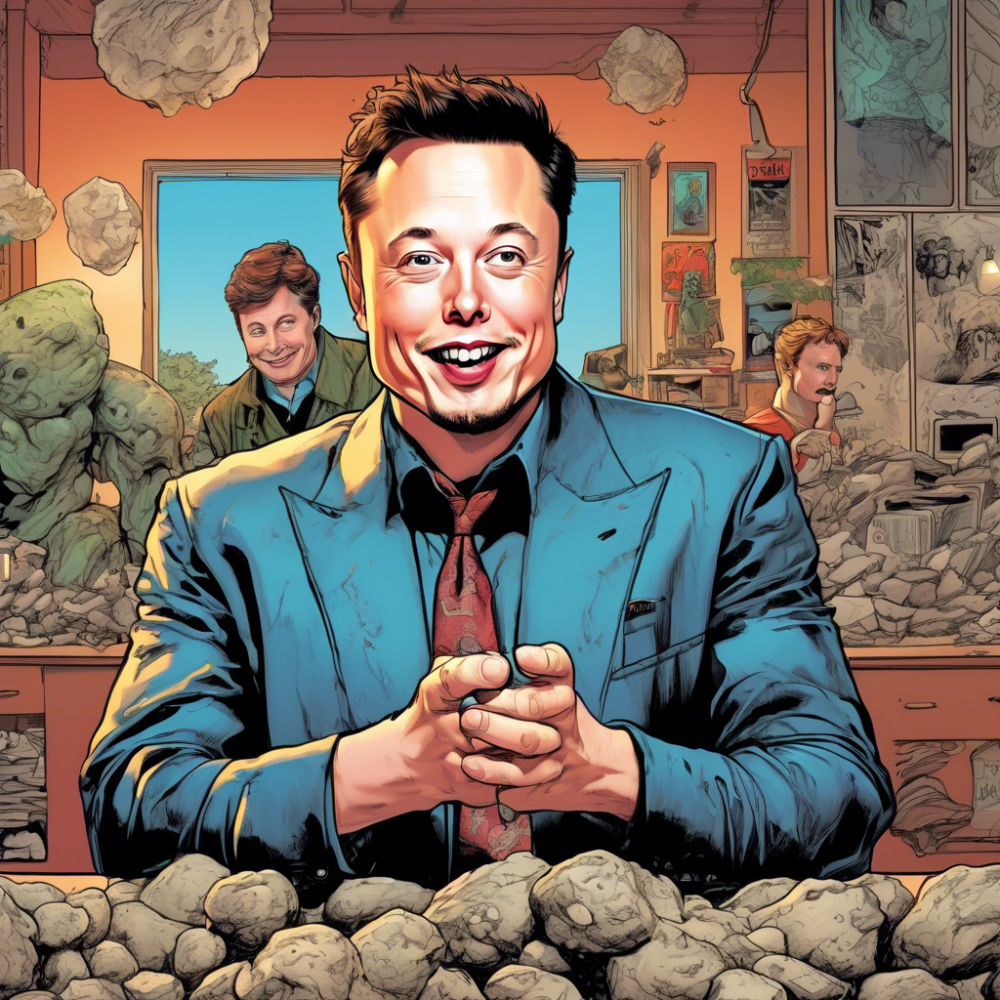

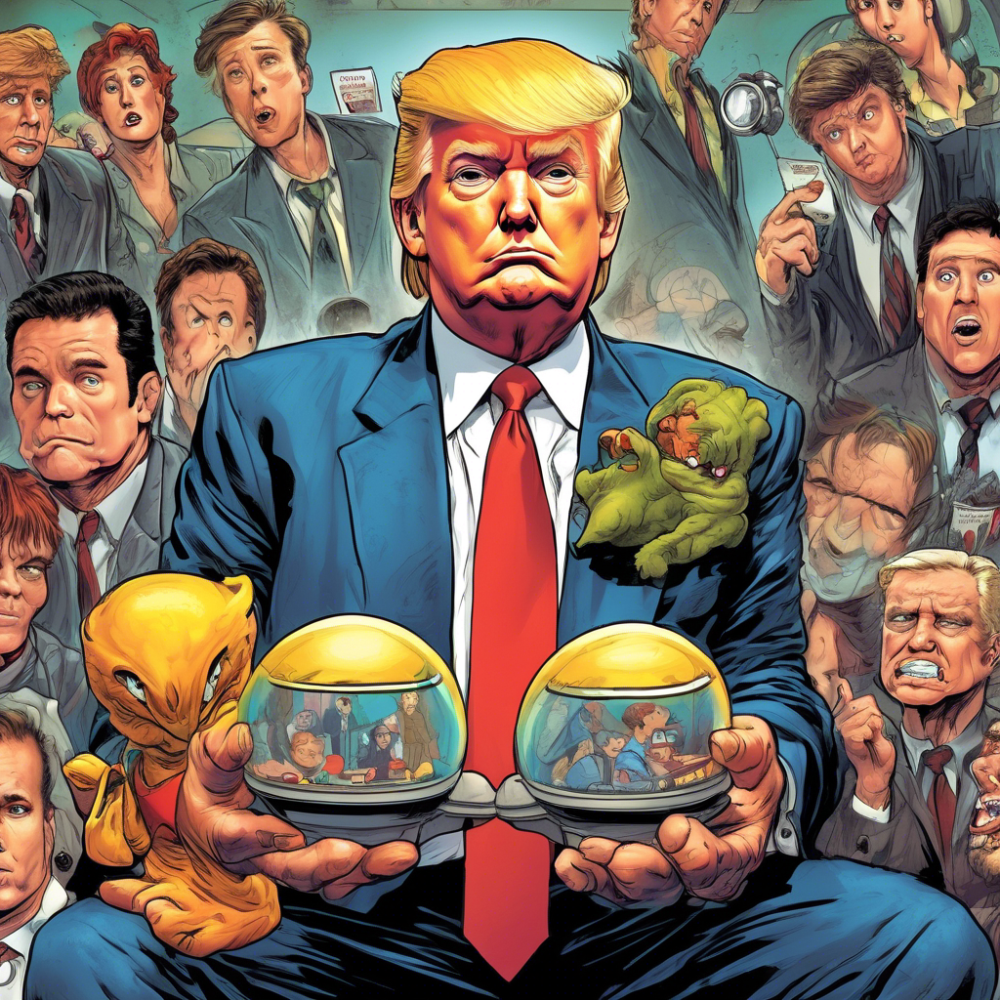

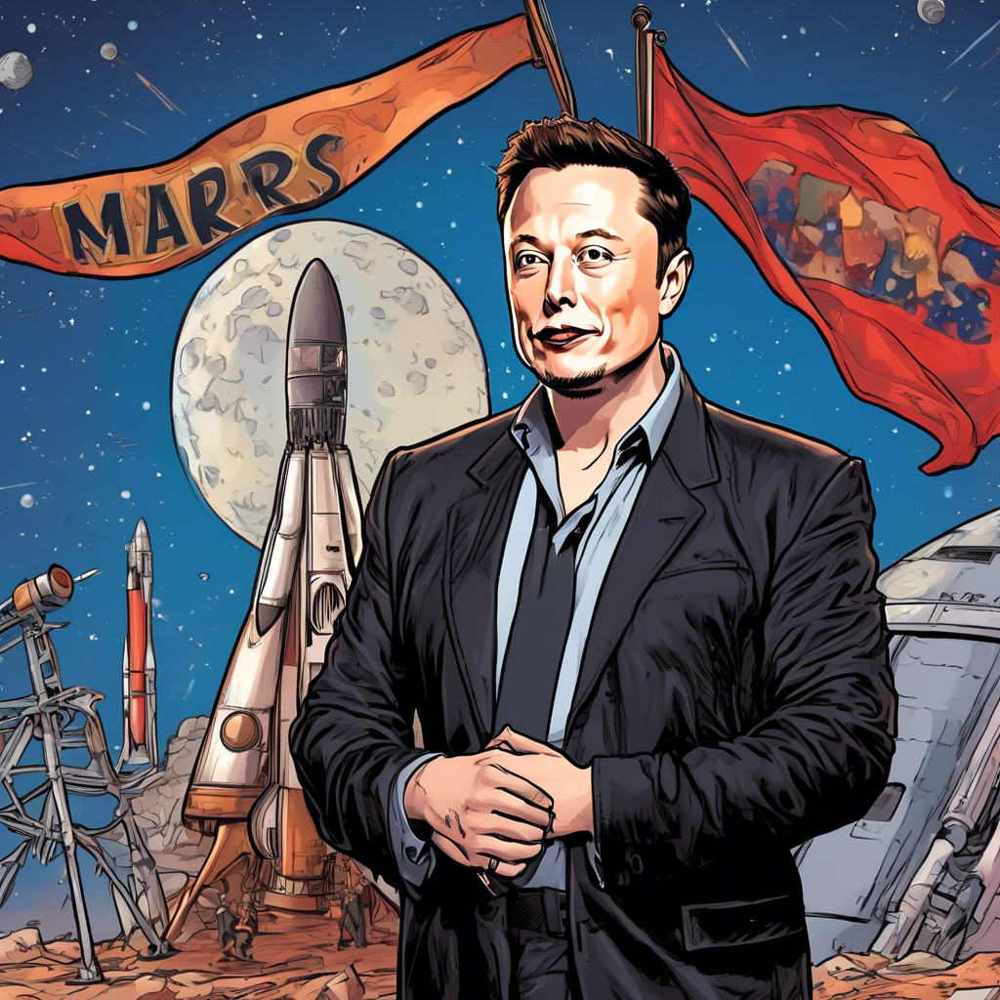

In [6]:
import glob,os
from IPython.display import Image
from stability import generate_image
from tqdm import tqdm

Image("your_image_filename.jpg")

counter = 1
for line in tqdm(lines, desc="Generating images"):
    prefix = f"./tmp/{counter}__"
    generate_image(prompt=line.image_prompt + ', ' + "on the sitcom how I met your mother (1993)", prefix=str(prefix), width=1024, height=1024)
    counter += 1

images = glob.glob('./tmp/*.png')
images.sort(key=os.path.getmtime)
for image in images:
    display(Image(image))

# Download a background music for the video

In [7]:
from freepd import MusicCategory, download_random_music
bgm = download_random_music(script.get('bgm_category', None) or random.choice(MusicCategory.values()))

Downloaded Be Chillin successfully.


# Use ffmpeg to merge all the voice clips and images to generate a short video.

In [8]:
from ffmpg import generate_movie
import os, glob
from model import SpeechClip

movie_data = [SpeechClip(
    caption=line.speech,
    image=image,
    audio=voiceover,
) for line, image, voiceover in zip(lines, images, voiceovers)]

if(not os.path.exists('./renders/')):
    os.makedirs('./renders/')
output_path = "./renders/output.mp4"

generate_movie(movie_data, bgm, './LGSmHaSB.ttf', output_path)

Rendering intermediate video clips: 100%|█████████████████████████████████████████████████████████████████████████████████| 7/7 [00:06<00:00,  1.11it/s]


Rendering final output to ./renders/output.mp4 ...


In [9]:
from IPython.display import Video

Video(output_path)